<a href="https://colab.research.google.com/github/aajinlee/Tomato_Disease_Detector/blob/main/tomato_disease_detector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import glob
import json
import warnings
warnings.filterwarnings("ignore")

In [ ]:
# 드라이브 마운트
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#정상 class에 따라 개수 세기
import os
import json

directory = '/content/drive/MyDrive/dataset_root/train/[라벨]토마토_정상'
class_counts = {}

for filename in os.listdir(directory):
    if filename.endswith('.json'):
        file_path = os.path.join(directory, filename)
        with open(file_path) as f:
            data = json.load(f)
            class_name = str(data['annotations'].get('disease'))
            class_counts[class_name] = class_counts.get(class_name, 0) + 1

for class_name, count in class_counts.items():
    print(f"{class_name}: {count}개")

0: 600개


In [ ]:
#질병 class에 따라 개수 세기
import os
import json

directory = '/content/drive/MyDrive/dataset_root/train/[라벨]11.토마토_9.증강'
class_counts = {}

for filename in os.listdir(directory):
    if filename.endswith('.json'):
        file_path = os.path.join(directory, filename)
        with open(file_path) as f:
            data = json.load(f)
            class_name = str(data['annotations'].get('disease'))
            class_counts[class_name] = class_counts.get(class_name, 0) + 1

for class_name, count in class_counts.items():
    print(f"{class_name}: {count}개")


0: 1200개
19: 11668개
18: 9306개


In [ ]:
import os
import json
import pandas as pd

directory = '/content/drive/MyDrive/dataset_root/train/label_json_aug'
class_counts = {}

for filename in os.listdir(directory):
    if filename.endswith('.json'):
        file_path = os.path.join(directory, filename)
        with open(file_path) as f:
            data = json.load(f)
            risk_class = str(data['annotations'].get('risk'))
            disease_class = str(data['annotations'].get('disease'))
            class_name = f"Risk:{risk_class}, Disease:{disease_class}"
            class_counts[class_name] = class_counts.get(class_name, 0) + 1

# 표로 변환하여 출력
df = pd.DataFrame(list(class_counts.items()), columns=['Class', 'Count'])
print(df)


                Class  Count
0  Risk:3, Disease:19   1832
1  Risk:2, Disease:19   7669
2   Risk:0, Disease:0   1200
3  Risk:1, Disease:19   2167
4  Risk:3, Disease:18   1243
5  Risk:2, Disease:18   4774
6  Risk:1, Disease:18   3289


In [ ]:
#조건에 맞는 파일 이름 반환하기
import os
import json

dir_path = '/content/drive/MyDrive/dataset_root/train/[라벨]11.토마토_9.증강'
target_disease = 1
matching_files = []

for filename in os.listdir(dir_path):
    file_path = os.path.join(dir_path, filename)
    with open(file_path, 'r') as f:
        data = json.load(f)
    if data['annotations']['disease'] == target_disease:
        matching_files.append(filename)

print(matching_files)


[]


In [ ]:
import os
import shutil

source_dir = '/content/drive/MyDrive/dataset_root/val/정상 라벨'
destination_dir = '/content/drive/MyDrive/dataset_root/val/[라벨]11.토마토_1.질병'


# 디렉토리 생성
if not os.path.exists(destination_dir):
    os.makedirs(destination_dir)

# .json 파일 이동
for filename in os.listdir(source_dir):
    if filename.lower().endswith(".json"):
        source_path = os.path.join(source_dir, filename)
        destination_path = os.path.join(destination_dir, filename)
        shutil.move(source_path, destination_path)

In [ ]:
#dir 안의 파일 개수
import os

directory = '/content/drive/MyDrive/dataset_root/train/labels_new'
file_count = len(os.listdir(directory))

print(f"디렉토리 안의 파일 개수: {file_count}개")


디렉토리 안의 파일 개수: 22174개


In [ ]:
import os
import shutil

source_dir = '/content/drive/MyDrive/dataset_root/train/11.토마토_9.증강_(1)'
destination_dir = '/content/drive/MyDrive/dataset_root/train/images'
file_count = len(os.listdir(source_dir))
print(f"디렉토리 안의 파일 개수: {file_count}개")
file_count = len(os.listdir(destination_dir))
print(f"디렉토리 안의 파일 개수: {file_count}개")
# .jpg 파일 이동
for filename in os.listdir(source_dir):
    if filename.lower().endswith((".jpg", ".jpeg")):
        source_path = os.path.join(source_dir, filename)
        destination_path = os.path.join(destination_dir, filename)
        shutil.move(source_path, destination_path)
file_count = len(os.listdir(destination_dir))
print(f"디렉토리 안의 파일 개수: {file_count}개")
print("파일 이동이 완료되었습니다.")

디렉토리 안의 파일 개수: 19010개
디렉토리 안의 파일 개수: 3164개
디렉토리 안의 파일 개수: 22174개
파일 이동이 완료되었습니다.


In [ ]:
dir = '/content/drive/MyDrive/dataset_root/val/images'
dir_label = '/content/drive/MyDrive/dataset_root/val/label_json'

# jpg 파일과 해당하는 json 파일 가져오기
image_files = [file for file in os.listdir(dir) if file.lower().endswith((".jpg", ".jpeg"))]
image_files.sort()

print(len(image_files))


for image_file in image_files:
    image_path = os.path.join(dir, image_file)
    json_file = image_file + ".json"
    json_path = os.path.join(dir_label, json_file)

    with open(json_path) as f:
        data = json.load(f)

    with open('/content/drive/MyDrive/dataset_root/val/label_json/' + json_file, 'r') as f:
        json_data = json.load(f)

        class_name = str(data['annotations']['disease'])
        risk_name = str(data['annotations']['risk'])

        image_name = data['description']['image']# 이미지 파일명
        image_width = data['description']['width'] # 이미지 넓이
        image_height = data['description']['height'] # 이미지 높이
        object_lst = [i for i in data['annotations']['points']]

        for i in object_lst:
           left = i["xtl"]
           right = i["xbr"]
           top = i["ytl"]
           bottom = i["ybr"]

        image_name = image_name.replace(".jpg", "").replace(".JPG", "").replace(".jpeg", "").replace(".JPEG", "")

        dir_txt = '/content/drive/MyDrive/dataset_root/train/labels_new'

        txt_filename = image_name + ".txt"
        txt_filepath = os.path.join(dir_txt, txt_filename)

        with open(txt_filepath, "w") as file:
            if class_name == '0':
                for annot in object_lst:
                    x1 = (left + right) / 2 / image_width
                    y1 = (top + bottom) / 2 / image_height
                    w = (right - left) / image_width
                    h = (bottom - top) / image_height
                    file.write(f"0 {x1:f} {y1:f} {w:f} {h:f}\n")
            elif class_name == '18'  :
                for annot in object_lst:
                    x1 = (left + right) / 2 / image_width
                    y1 = (top + bottom) / 2 / image_height
                    w = (right - left) / image_width
                    h = (bottom - top) / image_height
                    file.write(f"1 {x1:f} {y1:f} {w:f} {h:f}\n")
            elif class_name == '19' :
                for annot in object_lst:
                    x1 = (left + right) / 2 / image_width
                    y1 = (top + bottom) / 2 / image_height
                    w = (right - left) / image_width
                    h = (bottom - top) / image_height
                    file.write(f"2 {x1:f} {y1:f} {w:f} {h:f}\n")


        file.close()

22174


In [ ]:
import os

directory = "/content/drive/MyDrive/dataset_root/train/[라벨]11.토마토_1.질병"  # 실제 경로로 대체해주세요

# 주어진 경로의 파일 목록 가져오기
files = os.listdir(directory)

# .txt 파일 삭제
for file_name in files:
    if file_name.endswith(".txt"):
        file_path = os.path.join(directory, file_name)
        os.remove(file_path)

print(".txt 파일 삭제가 완료되었습니다.")


.txt 파일 삭제가 완료되었습니다.


In [ ]:
import os
import shutil

source_folder = '/content/drive/MyDrive/dataset_root/train/11.토마토_9.증강_(1)'
destination_folder = '/content/drive/MyDrive/dataset_root/train/images'

# 주어진 경로의 파일 목록 가져오기
files = os.listdir(source_folder)

# .jpg or .jpeg 파일을 이동
for file_name in files:
    if file_name.lower().endswith((".jpg", ".jpeg")):
        source_file = os.path.join(source_folder, file_name)
        destination_file = os.path.join(destination_folder, file_name)
        shutil.move(source_file, destination_file)

print("파일 이동이 완료되었습니다.")


파일 이동이 완료되었습니다.


In [ ]:
%cd '/content/drive/MyDrive'
!git clone https://github.com/ultralytics/ultralytics.git

/content/drive/MyDrive
fatal: destination path 'ultralytics' already exists and is not an empty directory.


In [ ]:
%cd '/content/drive/MyDrive/ultralytics'
!pip install -r requirements.txt

/content/drive/MyDrive/ultralytics


In [ ]:
!pip install PyYAML

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 626.9/626.9 kB 25.7 MB/s eta 0:00:00


In [ ]:
import ultralytics

ultralytics.checks()

Ultralytics YOLOv8.0.131 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 24.2/78.2 GB disk)


In [ ]:
from ultralytics import YOLO

#model = YOLO('yolov8x.pt')

In [ ]:
model.train(data = '/content/drive/MyDrive/dataset_root/data.yaml', epochs = 10, batch= 16)

In [ ]:
%cd '/content/drive/MyDrive/ultralytics'

!python train.py --img 416 --batch 16 --epochs 20 --data /content/drive/MyDrive/dataset_root/data.yaml --cfg ./models/yolov5s.yaml --weights yolov8s.pt --name results

/content/drive/MyDrive/ultralytics
python3: can't open file '/content/drive/MyDrive/ultralytics/train.py': [Errno 2] No such file or directory


In [ ]:
%cd '/content/drive/MyDrive/ultralytics'
model = YOLO('/content/drive/MyDrive/ultralytics_1/runs/detect/train3/weights/best.pt')
result = model.predict(source='/content/drive/MyDrive/KakaoTalk_20230707_143757295_02.jpg', save=True, imgsz=640)

/content/drive/MyDrive/ultralytics


image 1/1 /content/drive/MyDrive/KakaoTalk_20230707_143757295_02.jpg: 640x480 1 disease_2, 6.7ms
Speed: 2.6ms preprocess, 6.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)
Results saved to /content/drive/MyDrive/ultralytics/runs/detect/predict16


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


/content/drive/MyDrive/ultralytics



image 1/1 /content/drive/MyDrive/KakaoTalk_20230707_143733806.jpg: 640x480 1 disease_1, 7.0ms
Speed: 3.0ms preprocess, 7.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs/detect/predict23


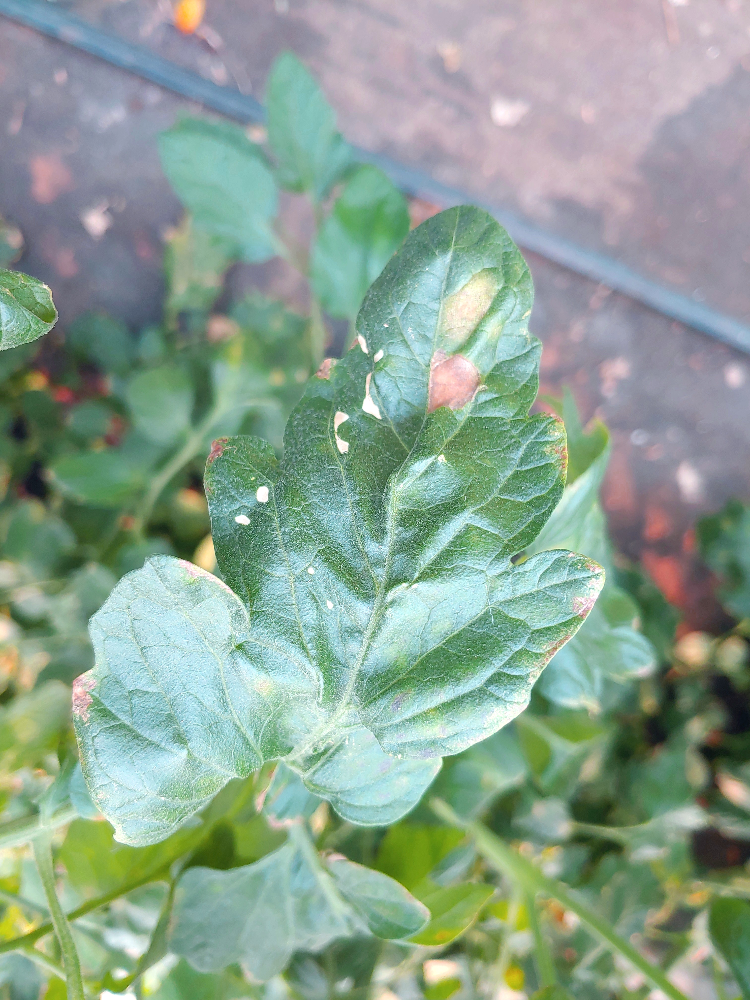

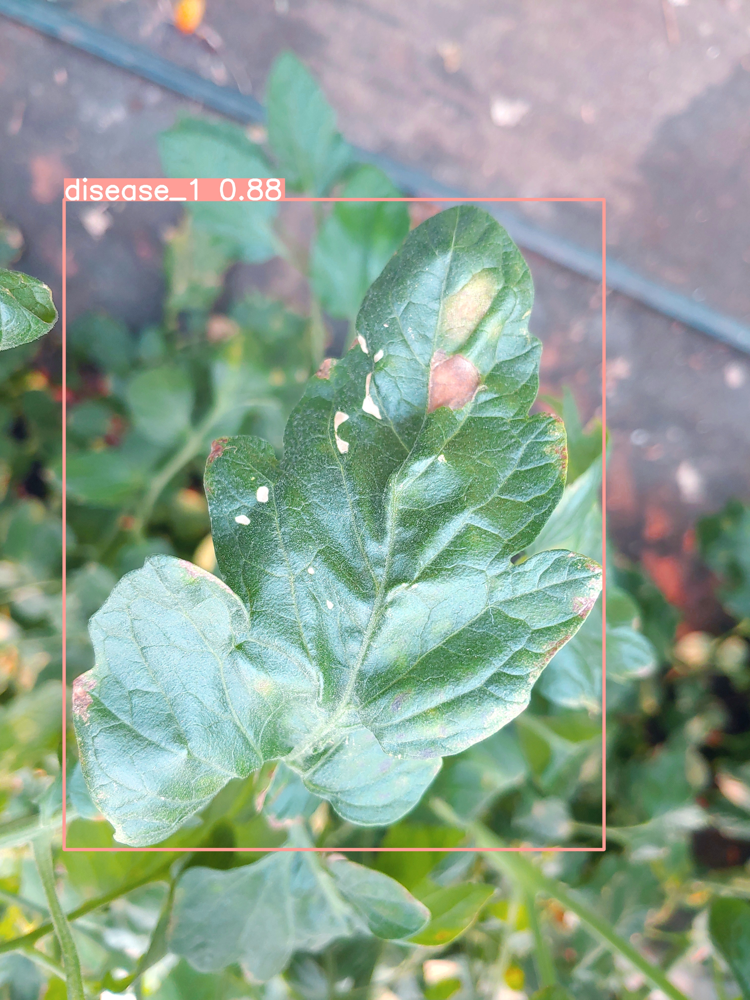

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

%cd '/content/drive/MyDrive/ultralytics'
original_image = cv2.imread('/content/drive/MyDrive/KakaoTalk_20230707_143733806.jpg')
model = YOLO('/content/drive/MyDrive/BEST.pt (class7 & class 3)/runs/detect/train3_성공 class 3개/weights/best.pt')
result = model.predict(source='/content/drive/MyDrive/KakaoTalk_20230707_143733806.jpg', save=True, imgsz=640)

# 이미지 출력
cv2_imshow(original_image)
# 이미지 로드
image = cv2.imread('/content/drive/MyDrive/ultralytics/runs/detect/predict24/KakaoTalk_20230707_143733806.jpg')

# 이미지 출력
cv2_imshow(image)

In [ ]:
%cd '/content/drive/MyDrive/ultralytics'
model = YOLO('/content/drive/MyDrive/BEST.pt (class7 & class 3)/runs/detect/train3_성공 class 3개/weights/best.pt')
result = model.predict(source='/content/drive/MyDrive/KakaoTalk_20230707_143757295_02.jpg', save=True, imgsz=640)

In [ ]:
%cd '/content/drive/MyDrive/ultralytics'
model = YOLO('/content/drive/MyDrive/BEST.pt (class7 & class 3)/runs/detect/train3_성공 class 3개/weights/best.pt')
result = model.predict(source='/content/drive/MyDrive/KakaoTalk_20230707_143757295_02.jpg', save=True, imgsz=640)